# 1. Helpers

In [ ]:
import numpy as np
import os, shutil

In [ ]:
class Helper():
  def unnormalize(self, img, mean, std):
    normal_image = img.detach().cpu()
    normal_image = normal_image.numpy().transpose((1,2,0))
    normal_image = std * normal_image + mean
    normal_image = np.clip(normal_image, 0, 1)
    return normal_image
  
  def create_dir(self, dir):
    if not os.path.isdir(dir):
      os.mkdir(dir)
    elif len(os.listdir(dir)) > 0:
      shutil.rmtree(dir)
      os.mkdir(dir)

  def display_images(self, X, num_examples, pixel_mean, pixel_std, show_labels=False, labels=[], y=[], save_fig=False, fig_name=""):
    figure = plt.figure(figsize=(10,10))

    for i in range(num_examples):
      plt.subplot(6,6,i+1)
      normal_image = self.unnormalize(X[i], pixel_mean, pixel_std)
      plt.imshow(normal_image, aspect="auto")
      plt.axis("off")

      if show_labels:
        plt.title(labels[y[i]].split("-")[1])

    plt.tight_layout()
    if save_fig:
      plt.savefig(fig_name)
    plt.show()

In [ ]:
helper = Helper()

# 2. Dataset

In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

In [ ]:
class Dataset():
  def __init__(self, root_dir, img_size, batch_size, pixel_mean, pixel_std):
    self.root_dir = root_dir
    self.img_size = img_size
    self.batch_size = batch_size
    self.pixel_mean = pixel_mean
    self.pixel_std = pixel_std
  
  def _download_dataset(self):
    if os.path.isdir(self.root_dir):
      return

    !rm -fr sample_data
    print("Downloading dataset...")
    !wget http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar -q
    print("Unzipping dataset...")
    !tar -xf images.tar
    os.rename("Images", self.root_dir)
  
  def _get_tfms(self):
    transformations = transforms.Compose([
        transforms.Resize(self.img_size),
        transforms.CenterCrop(self.img_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=self.pixel_mean, std=self.pixel_std)
    ])
  
    return transformations

  def get_dataset(self):
    self._download_dataset()
    print("Creating datasets...")
    transformations = self._get_tfms()
    train_ds = datasets.ImageFolder(root=self.root_dir, transform=transformations)
    labels = train_ds.classes
    print("Done!")
    return train_ds, labels
  
  def load_dataset(self, ds):
    dl = DataLoader(ds, batch_size=self.batch_size, shuffle=True)
    return dl

In [ ]:
ROOT_DIR = "dataset"
IMG_SIZE = 64
BATCH_SIZE = 128
PIXEL_MEAN = (0.5,0.5,0.5)
PIXEL_STD = (0.5,0.5,0.5)
     

data = Dataset(ROOT_DIR, IMG_SIZE, BATCH_SIZE, PIXEL_MEAN, PIXEL_STD)

In [ ]:
train_ds, labels = data.get_dataset()
train_dl = data.load_dataset(train_ds)

Unzipping dataset...
Creating datasets...
Done!


In [ ]:
print(f"{len(labels)} labels with {len(train_ds)} images of different dog breeds")

120 labels with 20580 images of different dog breeds


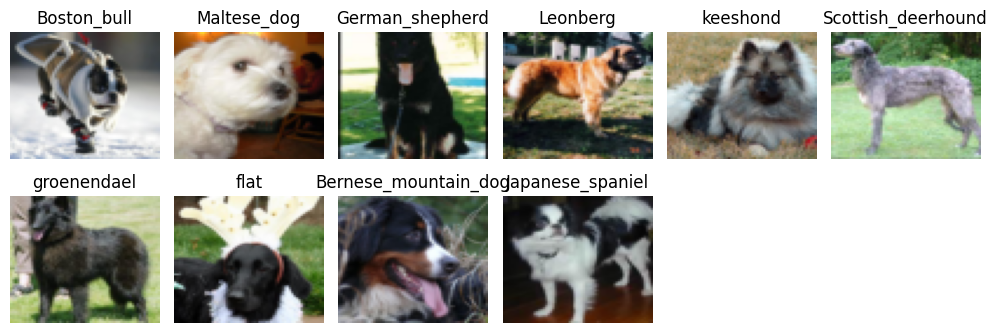

In [ ]:
X, y = next(iter(train_dl))
helper.display_images(X=X, num_examples=10, pixel_mean=PIXEL_MEAN, pixel_std=PIXEL_STD, show_labels=True, labels=labels, y=y)

# 3. Neural Networks
We will have two Neural Networks, the generator which takes in a random latent vector and gives back an image, the discriminator which takes the output image by the generator and tells us how fake the discriminator is.

In [ ]:
import torch
from torch import nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

## 3.1 Generator

In [ ]:
LATENT_V = 128

In [ ]:
class Generator(nn.Module):
  def __init__(self):
    super().__init__()

    self.main = nn.Sequential(
        nn.ConvTranspose2d(LATENT_V, 512, kernel_size=4, stride=2, padding=0, bias=False),
        nn.BatchNorm2d(512),
        nn.ReLU(True),
        # Out: 512, 4, 4

        nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(256),
        nn.ReLU(True),
        # Out: 256, 8, 8

        nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(128),
        nn.ReLU(True),
        # Out: 128, 16, 16

        nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        # Out: 64, 32, 32

        nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
        nn.Tanh()
        # Out: 3, 64, 64
    )
  
  def forward(self, input):
    return self.main(input)

In [ ]:
generator = Generator().to(device)
latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
fake_images = generator(latent)
fake_images.shape, fake_images[5].shape

(torch.Size([128, 3, 64, 64]), torch.Size([3, 64, 64]))

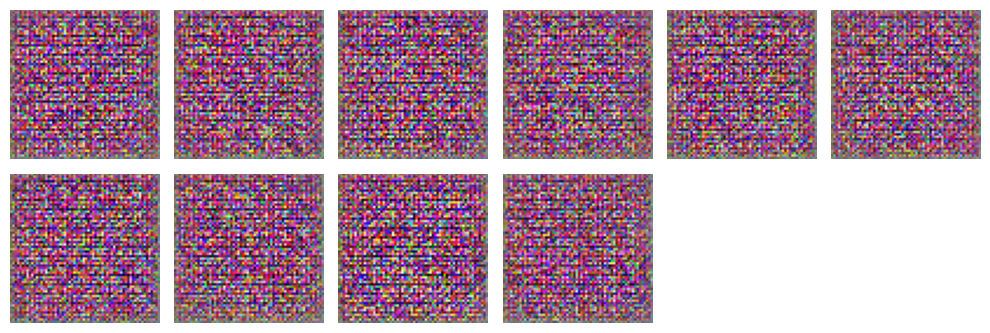

In [ ]:
helper.display_images(fake_images, 10, PIXEL_MEAN, PIXEL_STD)

## 3.2 Discriminator

In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super().__init__()

    self.main = nn.Sequential(
        nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 64, 32, 32

        nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(128),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 128, 16, 16

        nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(256),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 256, 8, 8

        nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(512),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 512, 4, 4

        nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
        # out: 1, 1, 1

        nn.Flatten(),
        nn.Sigmoid()
    )

  def forward(self, input):
    return self.main(input)

In [ ]:
discriminator = Discriminator().to(device)
decision = discriminator(fake_images)
decision.shape

torch.Size([128, 1])

# 4. Trainer
We will have three functions: train_generator (to train the generator), train_discriminator: (to train the discriminator), fit (to train both of them simultaniously)

In [ ]:
from tqdm.notebook import tqdm
from google.colab import files

In [ ]:
class Trainer():
  def __init__(self, optim_g, optim_d, generator, discriminator, pixel_mean, pixel_std):
    self.optim_g, self.optim_d, self.generator, self.discriminator, self.pixel_mean, self.pixel_std = optim_g, optim_d, generator, discriminator, pixel_mean, pixel_std

  def _train_generator(self):
    self.optim_g.zero_grad()

    # Generate fake images
    latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
    fake_images = self.generator(latent)

    # Get loss on fake images
    output = self.discriminator(fake_images)
    targets = torch.ones(BATCH_SIZE, 1, device=device)
    loss = F.binary_cross_entropy(output, targets)

    # Update weights
    loss.backward()
    self.optim_g.step()
    return loss.item()
  
  def _train_discriminator(self, real_images):
    self.optim_d.zero_grad()

    # Get loss on real images
    real_output = self.discriminator(real_images)
    real_targets = torch.ones(real_output.shape[0], 1, device=device)
    real_loss = F.binary_cross_entropy(real_output, real_targets)

    # Generate fake images
    latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
    fake_images = self.generator(latent)

    # Get loss on fake images
    fake_output = self.discriminator(fake_images)
    fake_targets = torch.zeros(fake_output.shape[0], 1, device=device)
    fake_loss = F.binary_cross_entropy(fake_output, fake_targets)

    loss = real_loss + fake_loss
    loss.backward()
    self.optim_d.step()
    return loss.item()
  
  def _save_checkpoint(self, zip_file_name):
    generator_model_path = f"{zip_file_name}/generator"
    discriminator_model_path = f"{zip_file_name}/discriminator"

    os.makedirs(generator_model_path, exist_ok=True)
    os.makedirs(discriminator_model_path, exist_ok=True)

    torch.save(generator.state_dict(), f"{generator_model_path}/generator.h5")
    torch.save(discriminator.state_dict(), f"{discriminator_model_path}/discriminator.h5")

    shutil.make_archive(zip_file_name, "zip", zip_file_name)
    files.download(f"{zip_file_name}.zip")

  
  def fit(self, num_epochs, create_dir=True, start_idx=0, save_after=99999):
    if create_dir:
      helper.create_dir("generated_images")

    losses_g = []
    losses_d = []

    for epoch in range(start_idx, num_epochs):
      print(f"----\nEpoch: {epoch}/{num_epochs}")
      for images, labels in tqdm(train_dl):
        images = images.to(device)
        loss_d = self._train_discriminator(images)
        loss_g = self._train_generator()
      
      losses_g.append(loss_g)
      losses_d.append(loss_d)

      latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
      fake_images = self.generator(latent)
      helper.display_images(X=fake_images, num_examples=10, pixel_mean=self.pixel_mean, pixel_std=self.pixel_std, save_fig=True, fig_name=f"generated_images/img_at_epoch_{epoch}")
      if (epoch) % save_after == 0:
        self._save_checkpoint(f"dog_gan_checkpoint_{epoch}")

      print(f"Generator loss: {loss_g}, Discriminator loss: {loss_d}")
  
    return {"gen_loss": losses_g, "dics_loss": losses_d}

# 5. Train model

In [ ]:
from torch import optim
from torch.nn import functional as F

## 5.1 Load a trained model
I have trained this a couple of times before so I am just loading that in.

In [ ]:
print("Upload models.zip file")
files.upload()
print("Unzipping...")
!unzip models.zip
print("Done!")

Upload models.zip file


Saving models.zip to models.zip
Unzipping...
Archive:  models.zip
   creating: discriminator/
   creating: generator/
  inflating: generator/generator.h5  
  inflating: discriminator/discriminator.h5  
Done!


In [ ]:
generator_model_path = "generator/generator.h5"
discriminator_model_path = "discriminator/discriminator.h5"

In [ ]:
generator.load_state_dict(torch.load(generator_model_path))
discriminator.load_state_dict(torch.load(discriminator_model_path))

<All keys matched successfully>

## 5.2 Train model

In [ ]:
lr = 0.0002
beta1, beta2 = 0.5, 0.999
epochs = 30

gen_optim = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, beta2))
disc_optim = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, beta2))

trainer = Trainer(gen_optim, disc_optim, generator=generator, discriminator=discriminator, pixel_mean=PIXEL_MEAN, pixel_std=PIXEL_STD)

----
Epoch: 1/100


  0%|          | 0/161 [00:00<?, ?it/s]

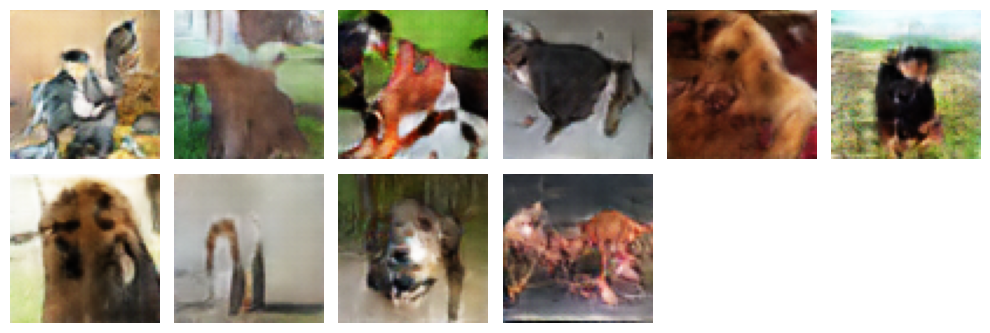

Generator loss: 4.557966232299805, Discriminator loss: 0.07917319983243942
----
Epoch: 2/100


  0%|          | 0/161 [00:00<?, ?it/s]

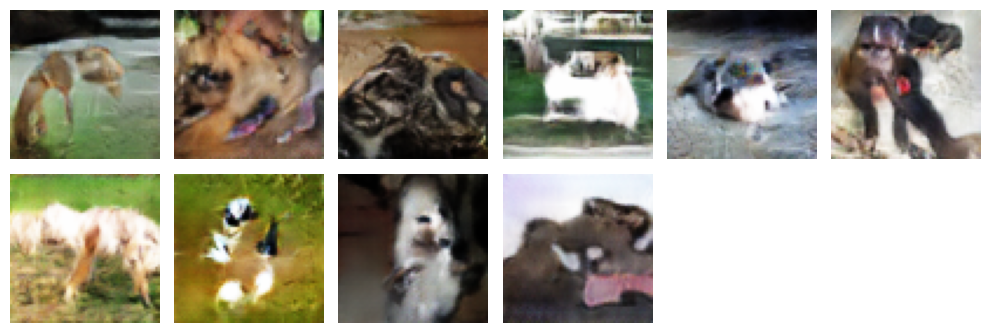

Generator loss: 4.498173236846924, Discriminator loss: 0.06124614551663399
----
Epoch: 3/100


  0%|          | 0/161 [00:00<?, ?it/s]

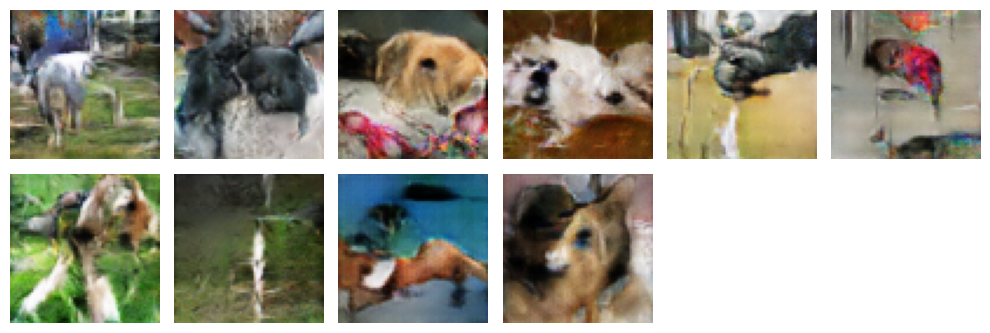

Generator loss: 6.973447799682617, Discriminator loss: 0.5495368242263794
----
Epoch: 4/100


  0%|          | 0/161 [00:00<?, ?it/s]

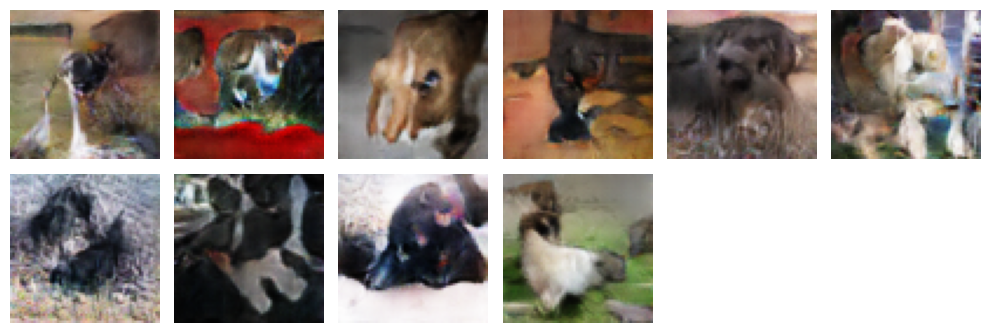

Generator loss: 4.4966888427734375, Discriminator loss: 0.07276272773742676
----
Epoch: 5/100


  0%|          | 0/161 [00:00<?, ?it/s]

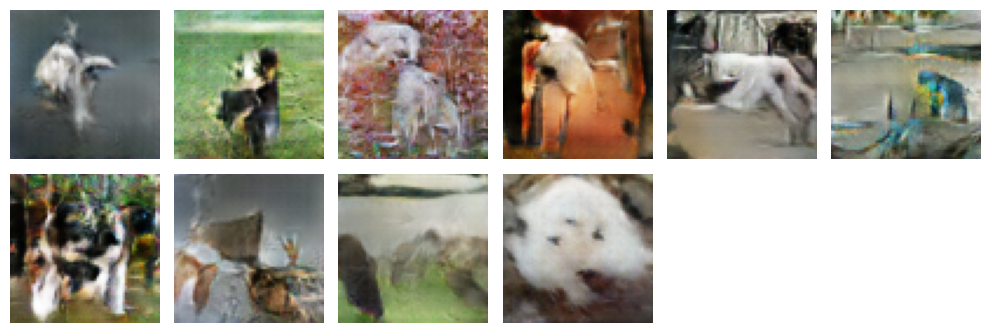

Generator loss: 3.793820858001709, Discriminator loss: 0.22507256269454956
----
Epoch: 6/100


  0%|          | 0/161 [00:00<?, ?it/s]

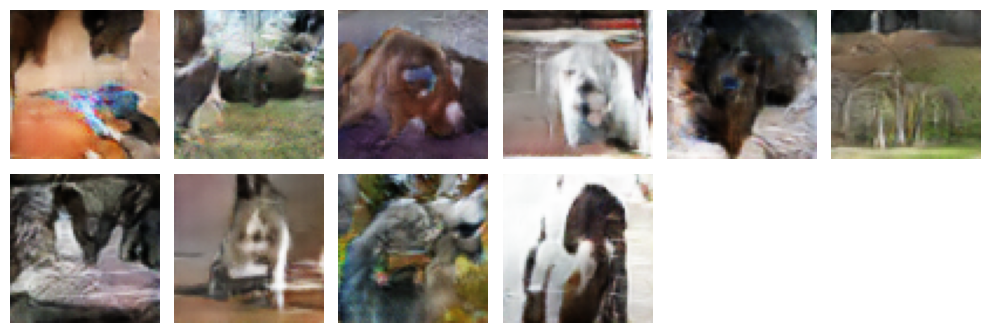

Generator loss: 3.8947558403015137, Discriminator loss: 0.09245866537094116
----
Epoch: 7/100


  0%|          | 0/161 [00:00<?, ?it/s]

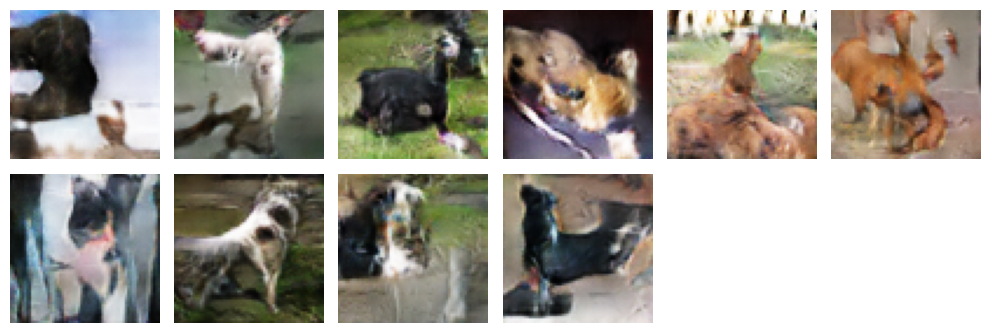

Generator loss: 5.125920295715332, Discriminator loss: 0.04090884327888489
----
Epoch: 8/100


  0%|          | 0/161 [00:00<?, ?it/s]

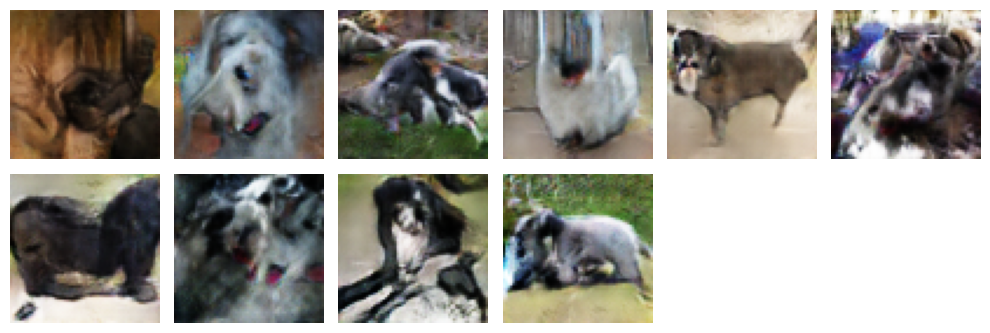

Generator loss: 4.695798873901367, Discriminator loss: 0.040357306599617004
----
Epoch: 9/100


  0%|          | 0/161 [00:00<?, ?it/s]

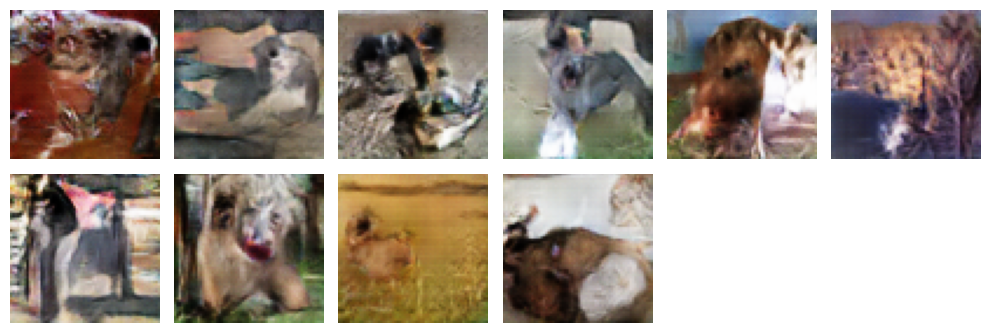

Generator loss: 2.685657024383545, Discriminator loss: 0.690118134021759
----
Epoch: 10/100


  0%|          | 0/161 [00:00<?, ?it/s]

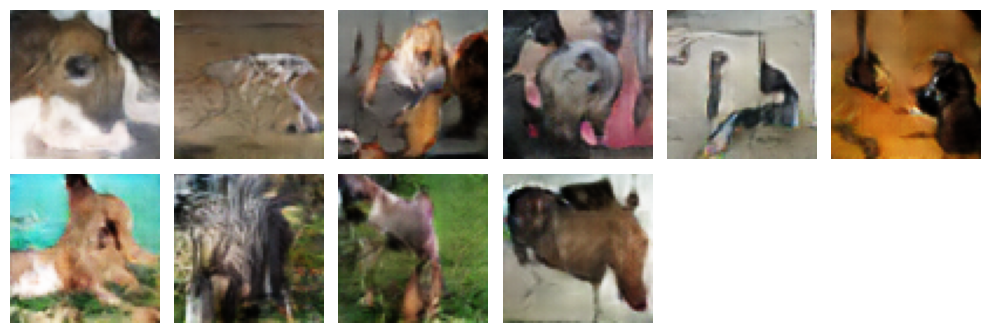

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Generator loss: 6.1374053955078125, Discriminator loss: 0.38423556089401245
----
Epoch: 11/100


  0%|          | 0/161 [00:00<?, ?it/s]

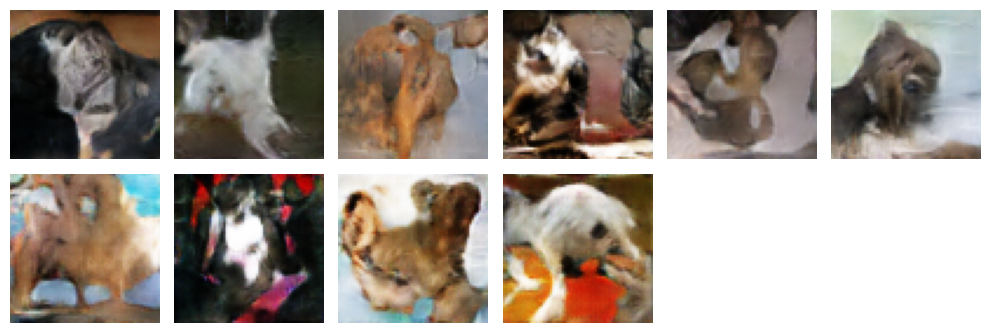

Generator loss: 4.390905857086182, Discriminator loss: 0.06352649629116058
----
Epoch: 12/100


  0%|          | 0/161 [00:00<?, ?it/s]

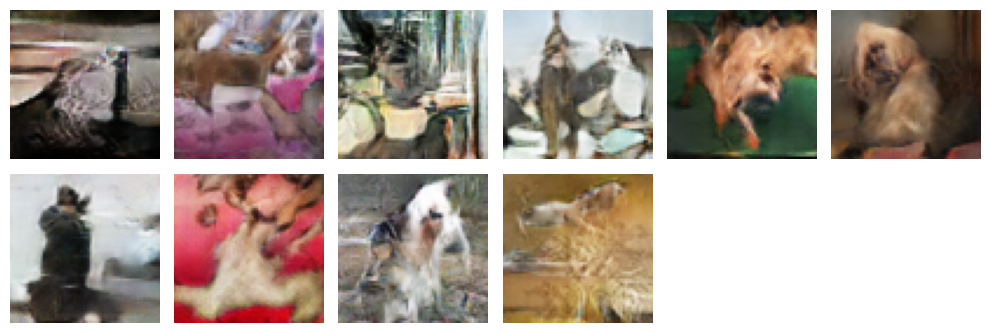

Generator loss: 4.18765115737915, Discriminator loss: 0.0537739098072052
----
Epoch: 13/100


  0%|          | 0/161 [00:00<?, ?it/s]

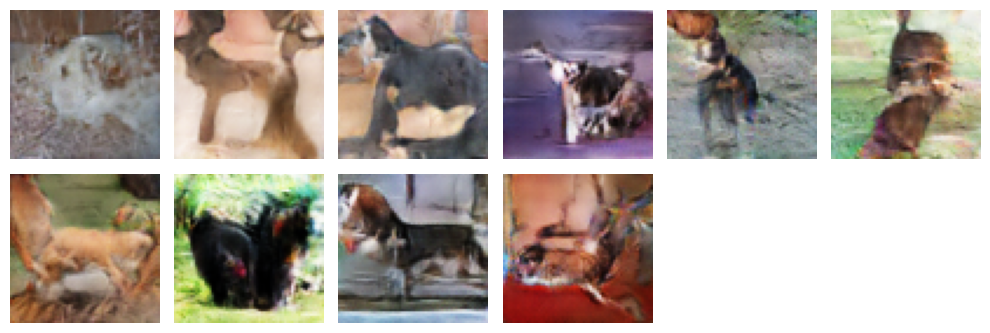

Generator loss: 4.63441276550293, Discriminator loss: 0.03399136662483215
----
Epoch: 14/100


  0%|          | 0/161 [00:00<?, ?it/s]

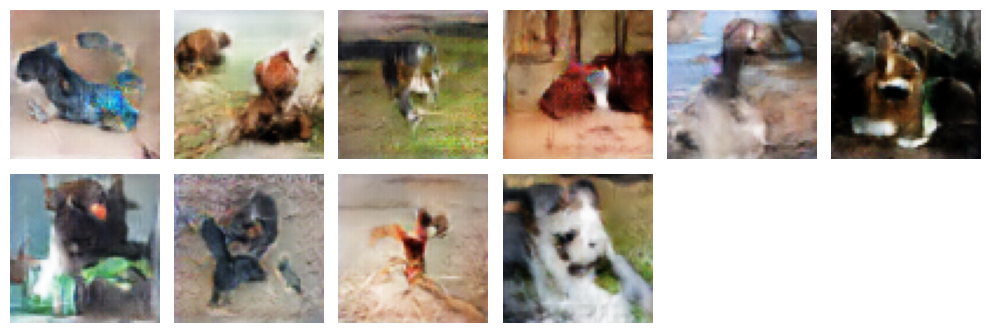

Generator loss: 4.899434566497803, Discriminator loss: 0.3763467073440552
----
Epoch: 15/100


  0%|          | 0/161 [00:00<?, ?it/s]

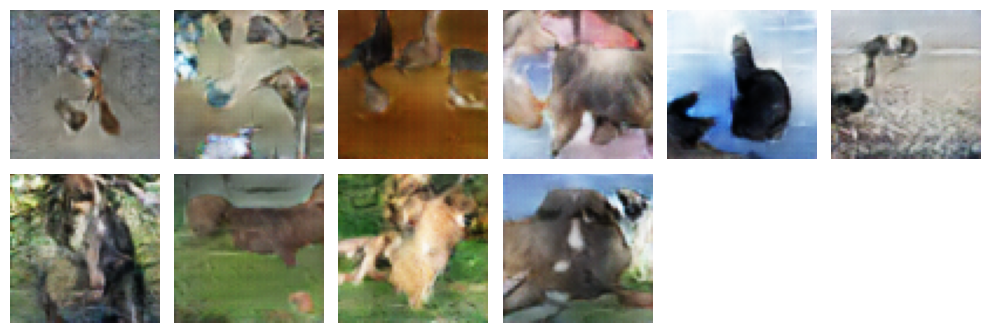

Generator loss: 4.053668975830078, Discriminator loss: 0.20224998891353607
----
Epoch: 16/100


  0%|          | 0/161 [00:00<?, ?it/s]

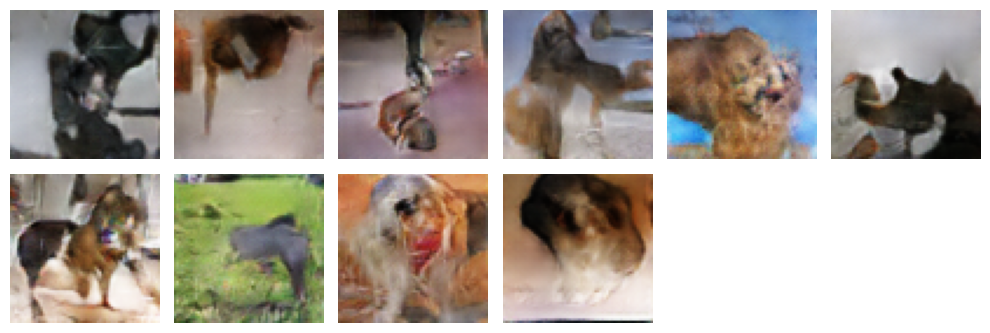

Generator loss: 4.876715183258057, Discriminator loss: 0.05652683228254318
----
Epoch: 17/100


  0%|          | 0/161 [00:00<?, ?it/s]

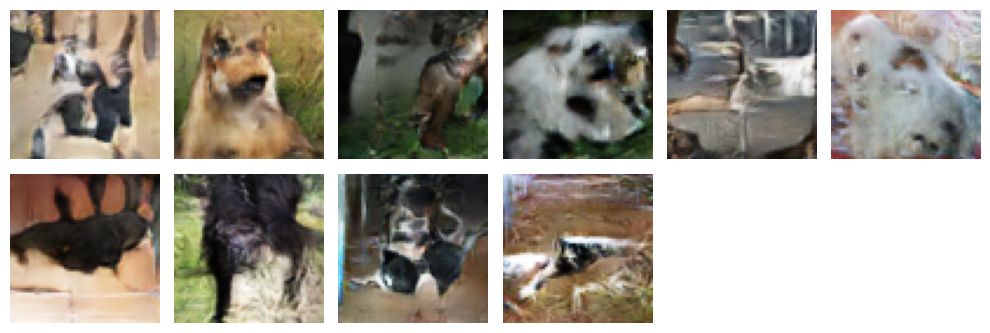

Generator loss: 5.687697410583496, Discriminator loss: 0.03796898573637009
----
Epoch: 18/100


  0%|          | 0/161 [00:00<?, ?it/s]

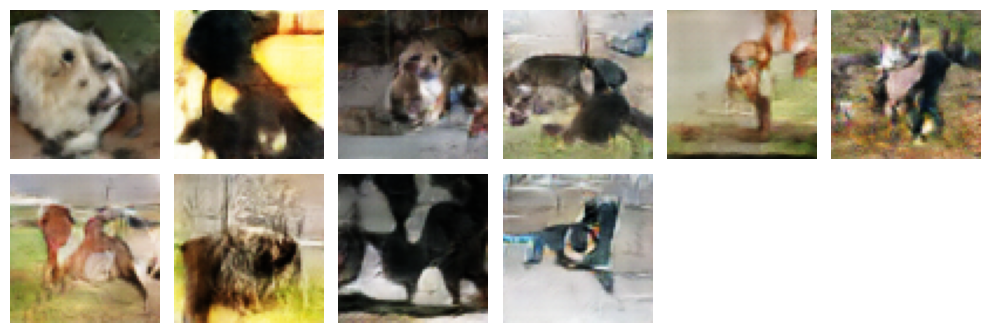

Generator loss: 0.20554578304290771, Discriminator loss: 5.18070650100708
----
Epoch: 19/100


  0%|          | 0/161 [00:00<?, ?it/s]

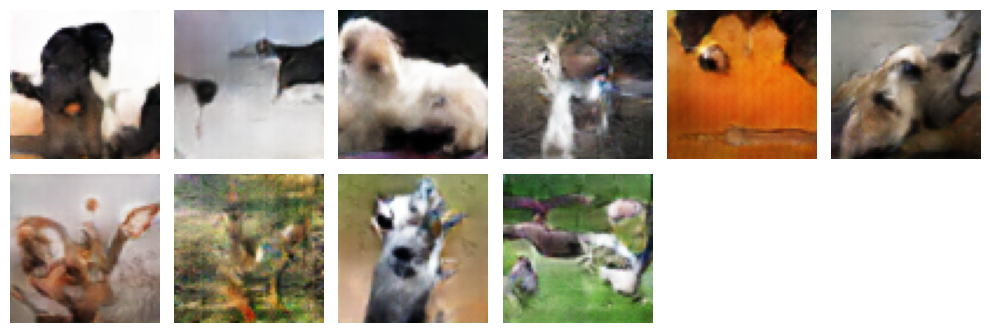

Generator loss: 5.222679615020752, Discriminator loss: 0.10390519350767136
----
Epoch: 20/100


  0%|          | 0/161 [00:00<?, ?it/s]

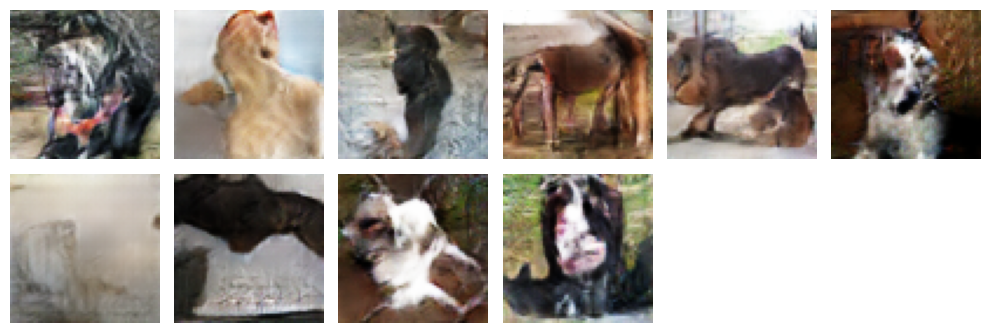

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Generator loss: 4.0799407958984375, Discriminator loss: 0.06271455436944962
----
Epoch: 21/100


  0%|          | 0/161 [00:00<?, ?it/s]

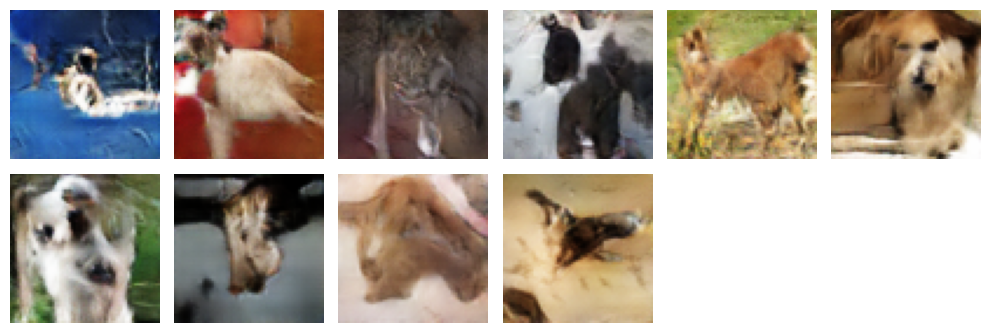

Generator loss: 4.914254188537598, Discriminator loss: 0.0396428257226944
----
Epoch: 22/100


  0%|          | 0/161 [00:00<?, ?it/s]

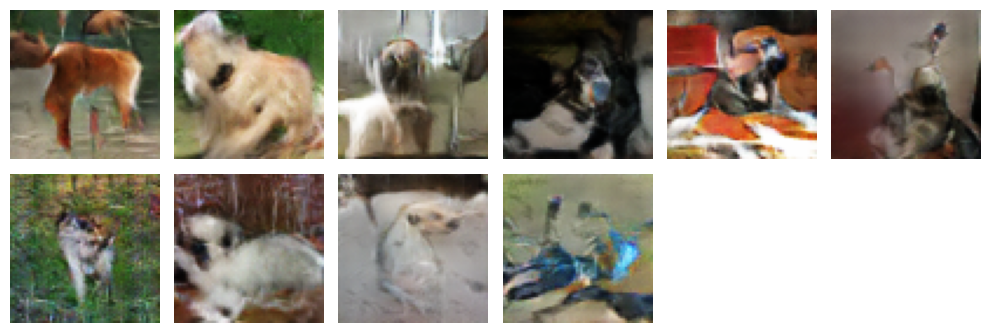

Generator loss: 5.004434585571289, Discriminator loss: 0.03558354079723358
----
Epoch: 23/100


  0%|          | 0/161 [00:00<?, ?it/s]

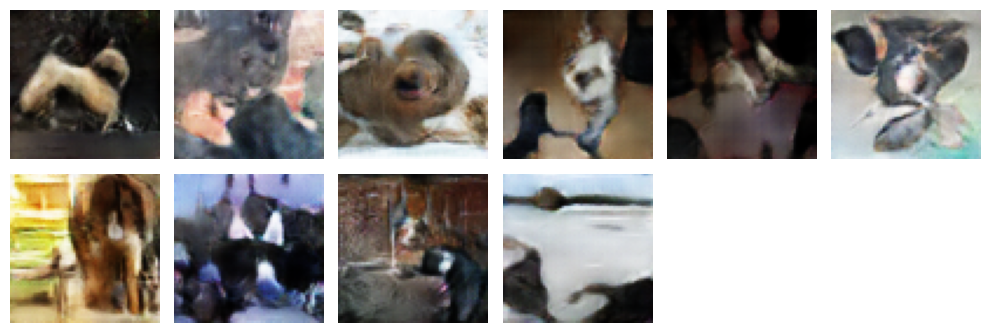

Generator loss: 4.108646392822266, Discriminator loss: 0.1417674720287323
----
Epoch: 24/100


  0%|          | 0/161 [00:00<?, ?it/s]

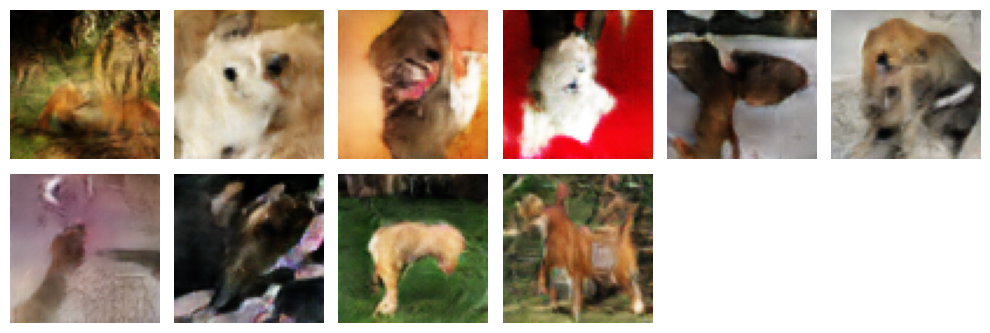

Generator loss: 4.961484909057617, Discriminator loss: 0.06593312323093414
----
Epoch: 25/100


  0%|          | 0/161 [00:00<?, ?it/s]

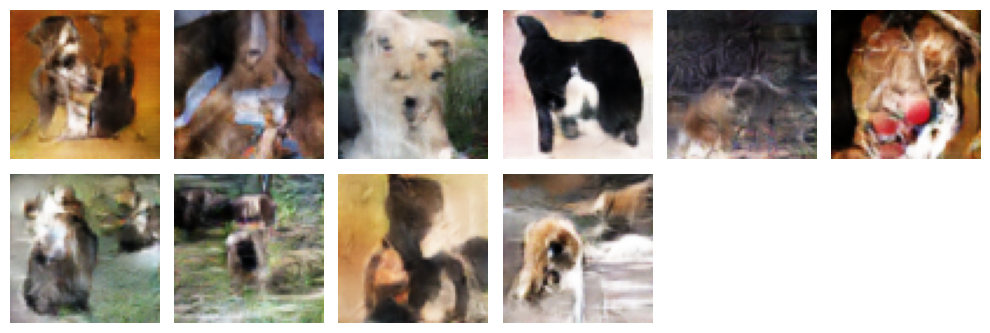

Generator loss: 4.114992618560791, Discriminator loss: 0.06387925148010254
----
Epoch: 26/100


  0%|          | 0/161 [00:00<?, ?it/s]

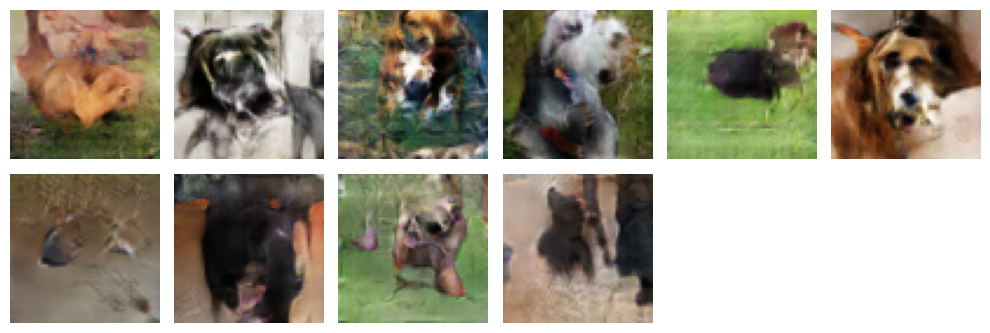

Generator loss: 4.7248334884643555, Discriminator loss: 0.03833942860364914
----
Epoch: 27/100


  0%|          | 0/161 [00:00<?, ?it/s]

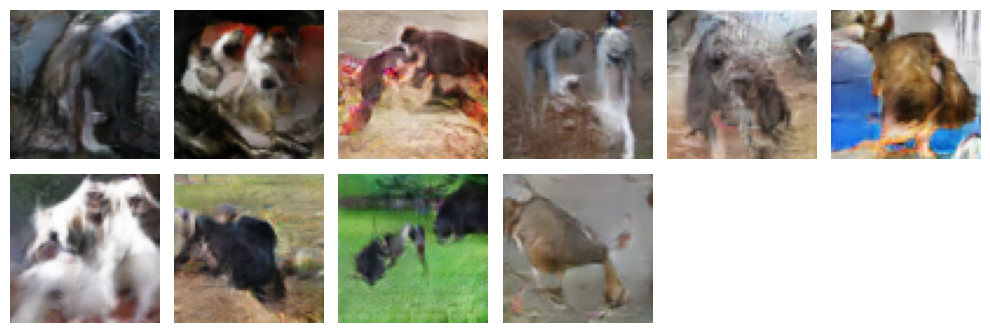

Generator loss: 3.007798671722412, Discriminator loss: 0.09738745540380478
----
Epoch: 28/100


  0%|          | 0/161 [00:00<?, ?it/s]

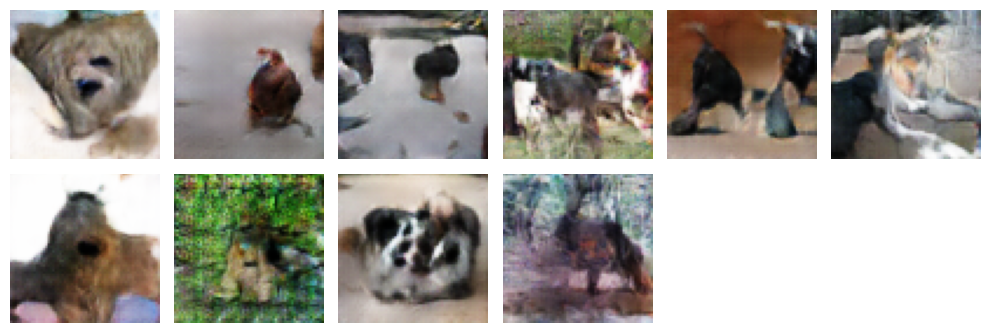

Generator loss: 2.4924867153167725, Discriminator loss: 0.3417865037918091
----
Epoch: 29/100


  0%|          | 0/161 [00:00<?, ?it/s]

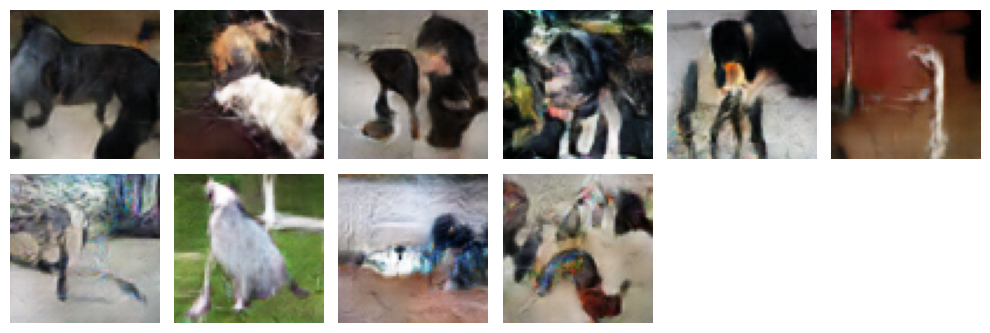

Generator loss: 4.511943817138672, Discriminator loss: 0.05057602375745773
----
Epoch: 30/100


  0%|          | 0/161 [00:00<?, ?it/s]

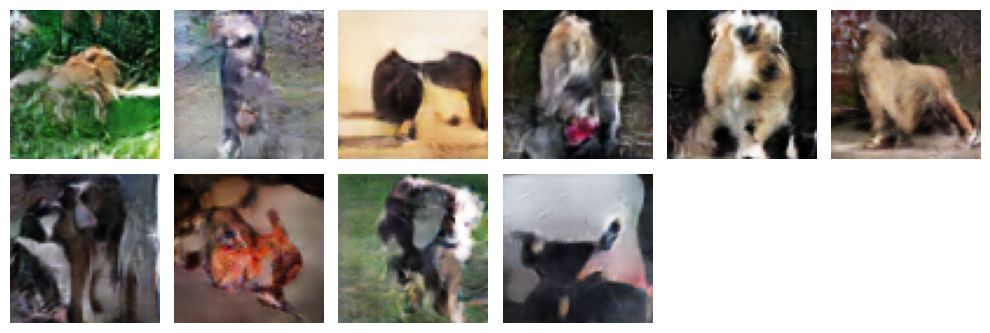

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Generator loss: 4.874031066894531, Discriminator loss: 0.06746405363082886
----
Epoch: 31/100


  0%|          | 0/161 [00:00<?, ?it/s]

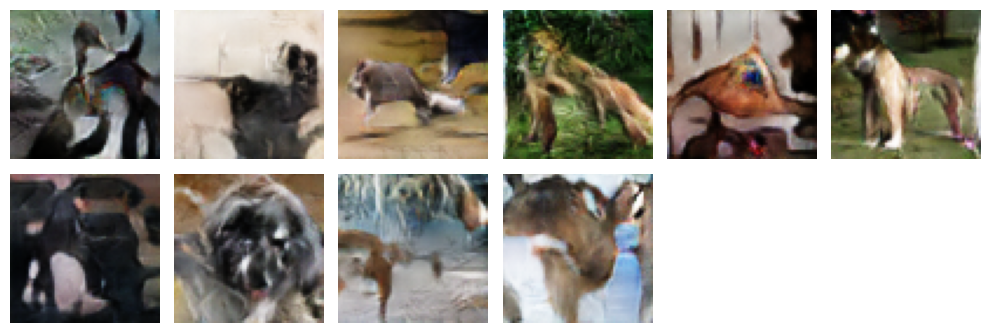

Generator loss: 4.2989821434021, Discriminator loss: 0.048570964485406876
----
Epoch: 32/100


  0%|          | 0/161 [00:00<?, ?it/s]

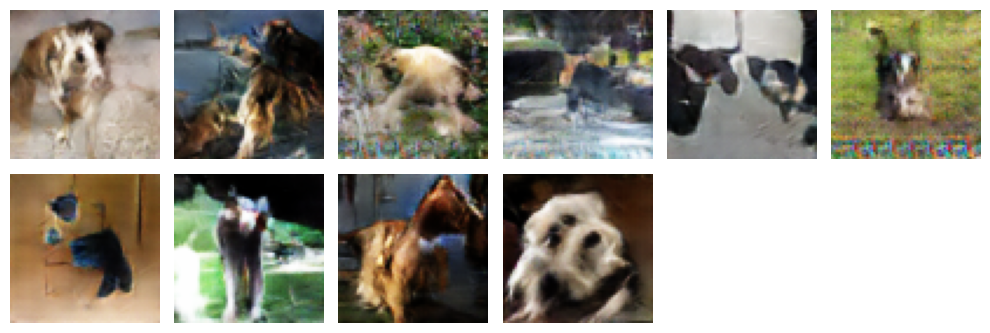

Generator loss: 4.597094535827637, Discriminator loss: 0.03982119634747505
----
Epoch: 33/100


  0%|          | 0/161 [00:00<?, ?it/s]

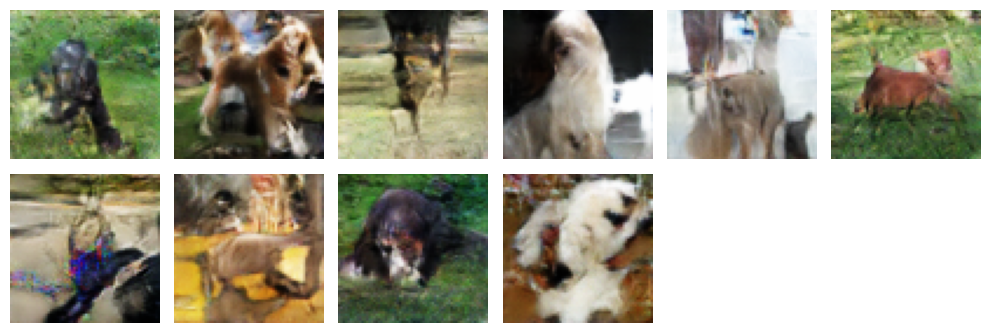

Generator loss: 4.657262802124023, Discriminator loss: 0.03351389616727829
----
Epoch: 34/100


  0%|          | 0/161 [00:00<?, ?it/s]

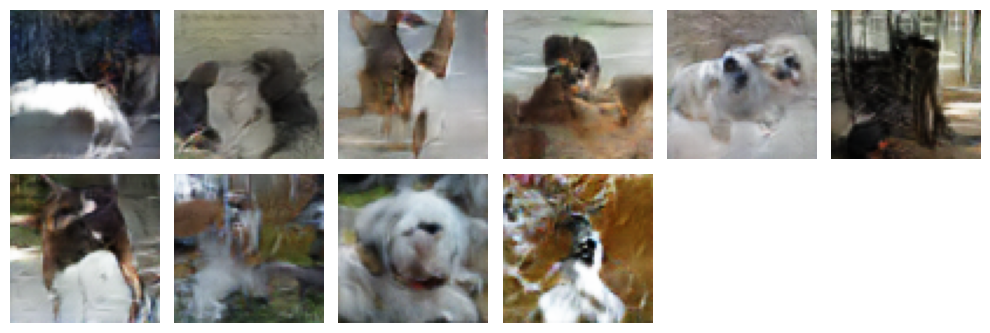

Generator loss: 6.371630668640137, Discriminator loss: 0.04518962278962135
----
Epoch: 35/100


  0%|          | 0/161 [00:00<?, ?it/s]

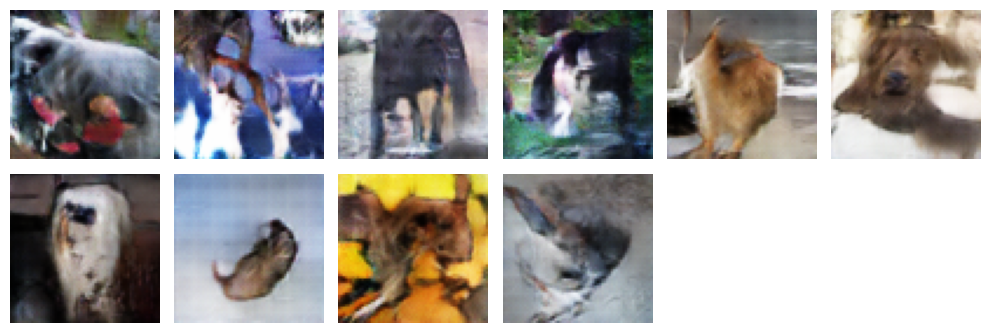

Generator loss: 1.6383633613586426, Discriminator loss: 1.1825382709503174
----
Epoch: 36/100


  0%|          | 0/161 [00:00<?, ?it/s]

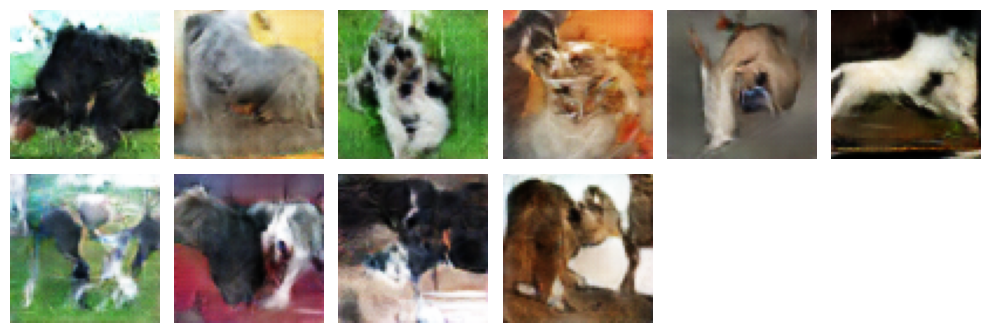

Generator loss: 3.99013352394104, Discriminator loss: 0.2569705843925476
----
Epoch: 37/100


  0%|          | 0/161 [00:00<?, ?it/s]

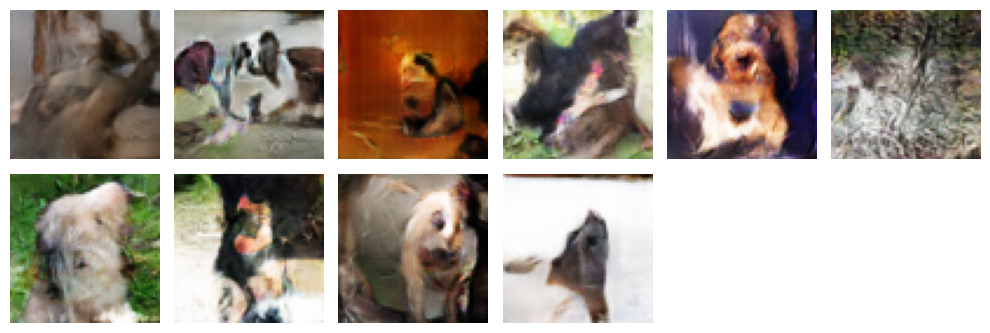

Generator loss: 5.136563777923584, Discriminator loss: 0.13530489802360535
----
Epoch: 38/100


  0%|          | 0/161 [00:00<?, ?it/s]

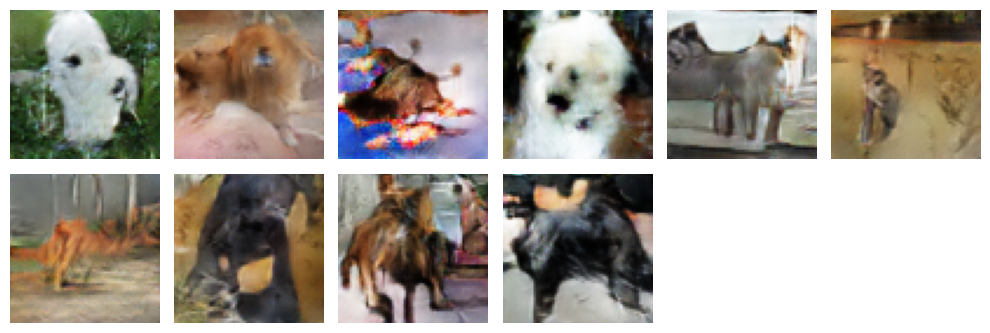

Generator loss: 4.567876815795898, Discriminator loss: 0.04388383775949478
----
Epoch: 39/100


  0%|          | 0/161 [00:00<?, ?it/s]

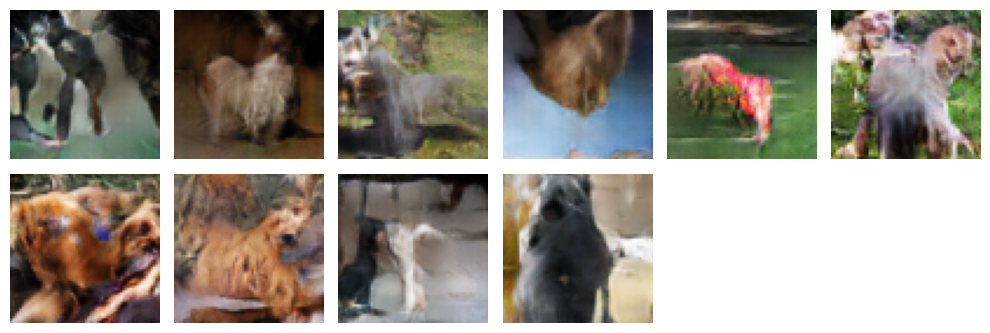

Generator loss: 7.018077850341797, Discriminator loss: 0.17978884279727936
----
Epoch: 40/100


  0%|          | 0/161 [00:00<?, ?it/s]

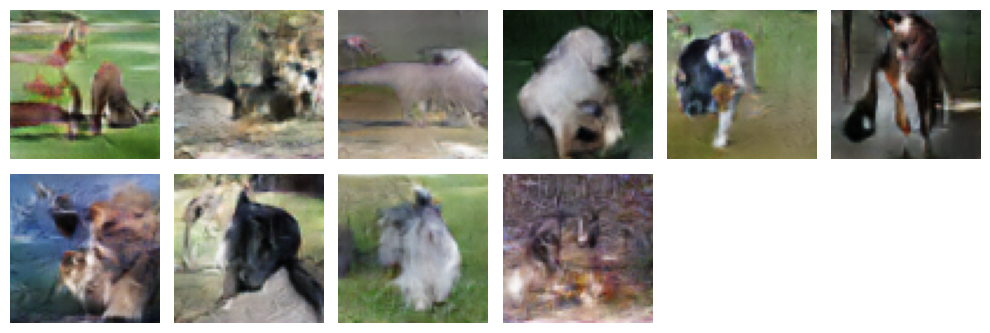

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Generator loss: 4.135727882385254, Discriminator loss: 0.06261303275823593
----
Epoch: 41/100


  0%|          | 0/161 [00:00<?, ?it/s]

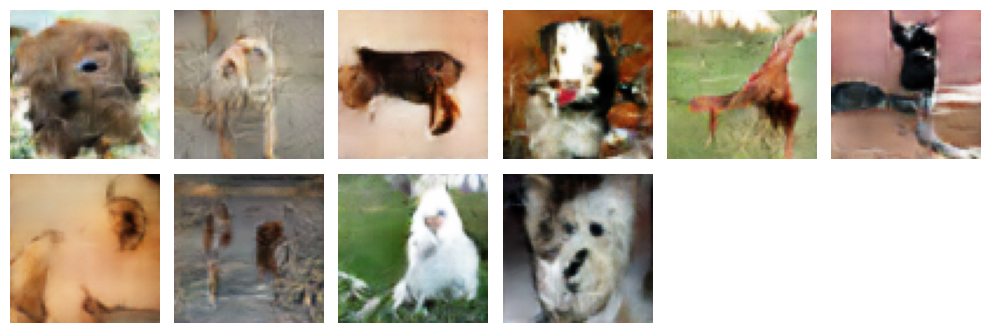

Generator loss: 5.9856438636779785, Discriminator loss: 0.028527110815048218
----
Epoch: 42/100


  0%|          | 0/161 [00:00<?, ?it/s]

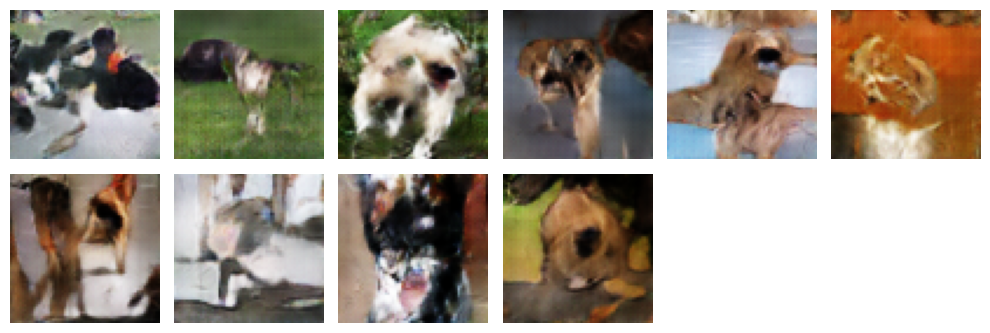

Generator loss: 2.4531004428863525, Discriminator loss: 1.8083428144454956
----
Epoch: 43/100


  0%|          | 0/161 [00:00<?, ?it/s]

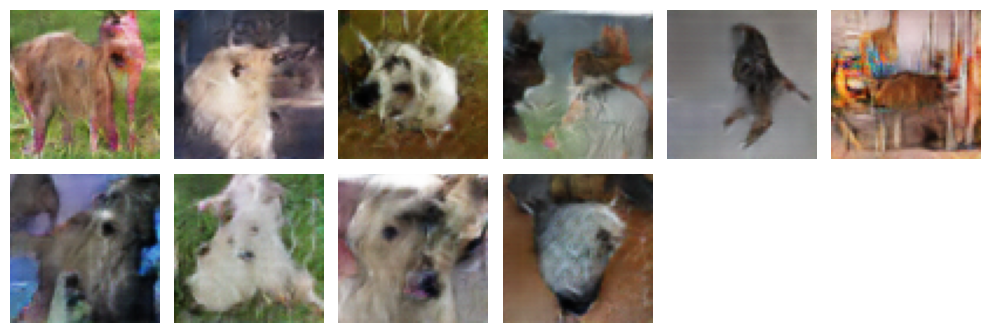

Generator loss: 5.103018760681152, Discriminator loss: 0.44563353061676025
----
Epoch: 44/100


  0%|          | 0/161 [00:00<?, ?it/s]

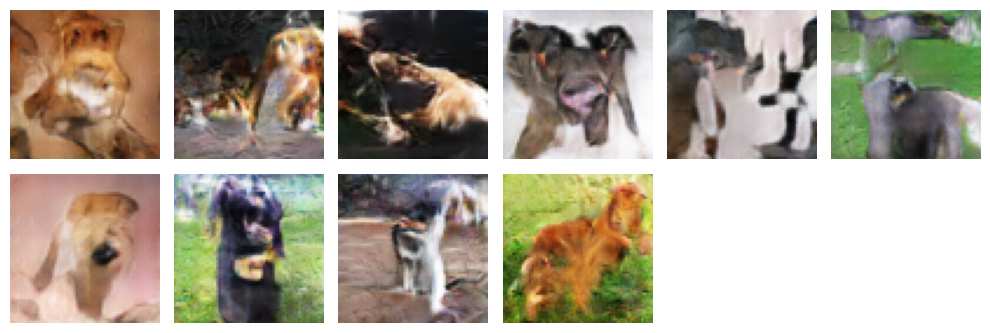

Generator loss: 4.9112467765808105, Discriminator loss: 0.10190531611442566
----
Epoch: 45/100


  0%|          | 0/161 [00:00<?, ?it/s]

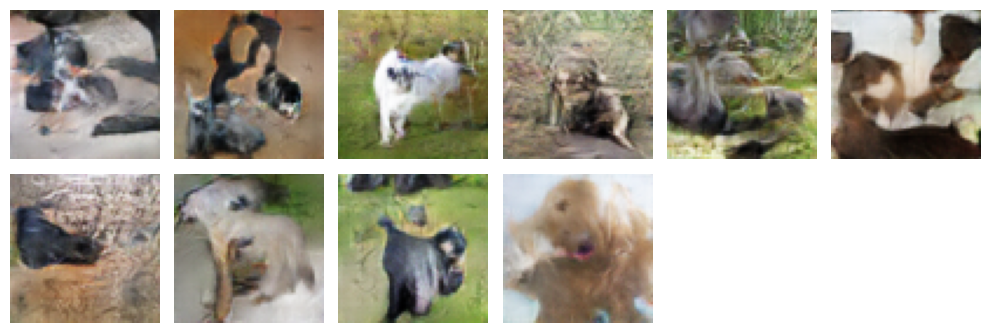

Generator loss: 4.177270889282227, Discriminator loss: 0.1002943143248558
----
Epoch: 46/100


  0%|          | 0/161 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [26]:
# training for longer periods of time
history = trainer.fit(100, create_dir=True, start_idx=1, save_after=10)

# 7. Save and download model and pictures

## 7.1 Save models

In [ ]:
generator_dir_path = "models/generator"
discriminator_dir_path = "models/discriminator"

In [ ]:
os.makedirs(generator_model_path, exist_ok=True)
os.makedirs(discriminator_model_path, exist_ok=True)

In [ ]:
torch.save(generator.state_dict(), f"{generator_model_path}/generator.h5")
torch.save(discriminator.state_dict(), f"{discriminator_model_path}/discriminator.h5")

## 7.2 Download models and pictures
We will zip the models folder and then just download it from the colab filesystem

In [ ]:
!zip -r models.zip models